In [1]:
from __future__ import annotations

import datetime

import numpy as np
import pandas as pd

# import plotly.io
# plotly.io.renderers.default = "svg"
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from ydata_profiling import ProfileReport

In [2]:
train_df = pd.read_csv("./data/train.csv")
test_df = pd.read_csv("./data/test.csv")

# person_age 	Age 年齡
# person_income 	Annual Income 年收入
# person_home_ownership 	Home ownership 居所
# person_emp_length 	Employment length (in years) 雇傭期
# loan_intent 	Loan intent 貸款意向
# loan_grade 	Loan grade 貸款級別
# loan_amnt 	Loan amount 貸款金額
# loan_int_rate 	Interest rate 利率
# loan_status 	Loan status (0 is non default 1 is default)
# 貸款狀態（0 為非違約，1 為違約）
# loan_percent_income 	Percent income 收入百分比
# cb_person_default_on_file 	Historical default 歷史違約
# cb_preson_cred_hist_length 	Credit history length 信用歷史長度

In [15]:
# fig = go.Figure(
#     [
#         go.Scatter(
#             x=train_df['loan_amnt'] / train_df['person_income'],
#             y=train_df['loan_percent_income'],
#             mode='markers',
#         ),
#     ]
# )
# fig.show()

In [5]:
# train_df["person_age"].value_counts()

In [6]:
# train_df.groupby("person_age")["loan_status"].sum()

In [7]:
# profile = ProfileReport(train_df, title="Profiling Report")
# with open("./train_profile.html", "w") as fp:
#     fp.write(profile.to_html())

In [8]:
# profile = ProfileReport(test_df, title="Profiling Report")
# with open("./test_profile.html", "w") as fp:
#     fp.write(profile.to_html())

In [9]:
train_df.dtypes

id                              int64
person_age                      int64
person_income                   int64
person_home_ownership          object
person_emp_length             float64
loan_intent                    object
loan_grade                     object
loan_amnt                       int64
loan_int_rate                 float64
loan_percent_income           float64
cb_person_default_on_file      object
cb_person_cred_hist_length      int64
loan_status                     int64
dtype: object

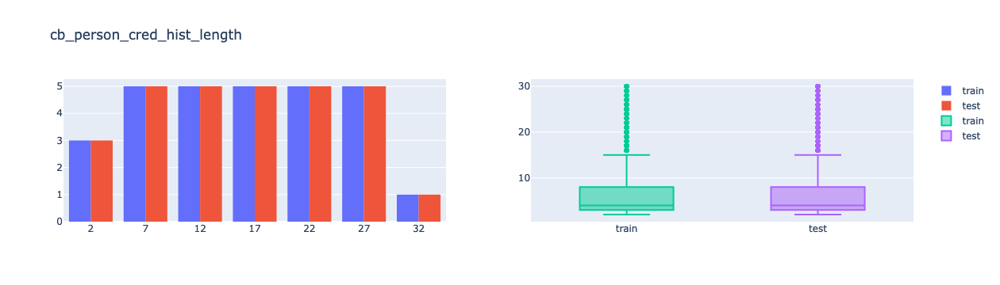

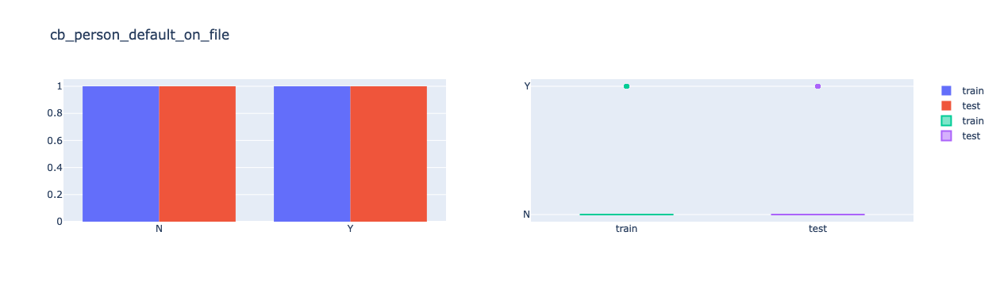

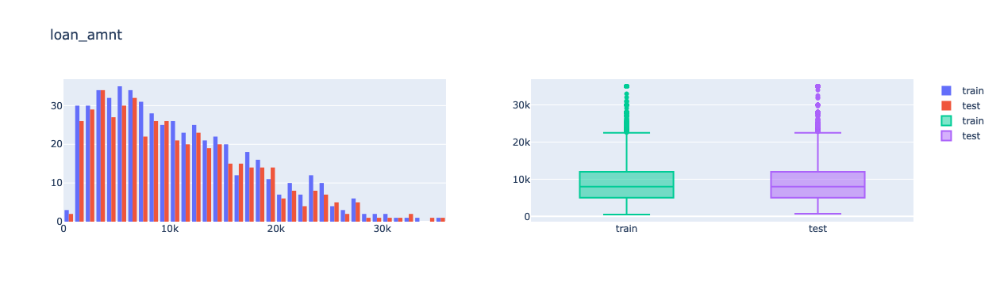

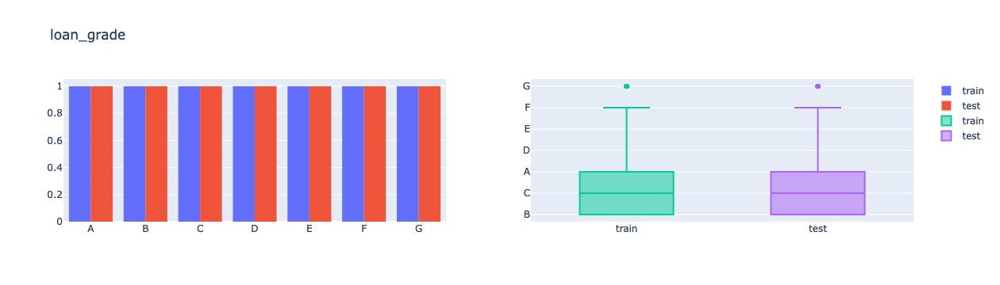

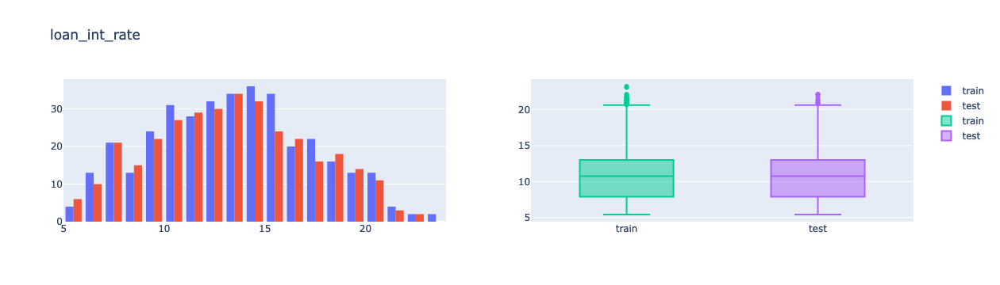

...

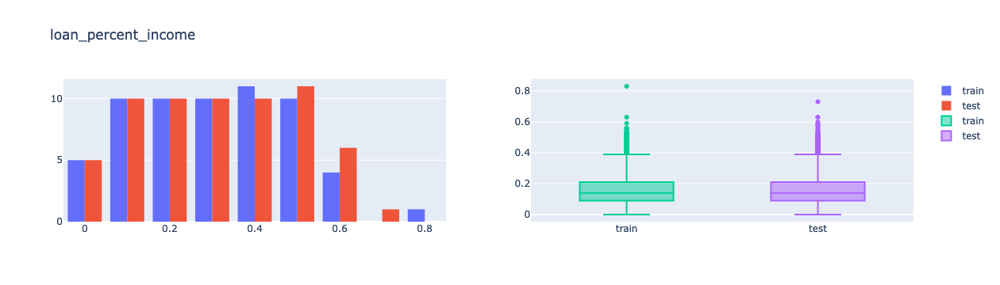

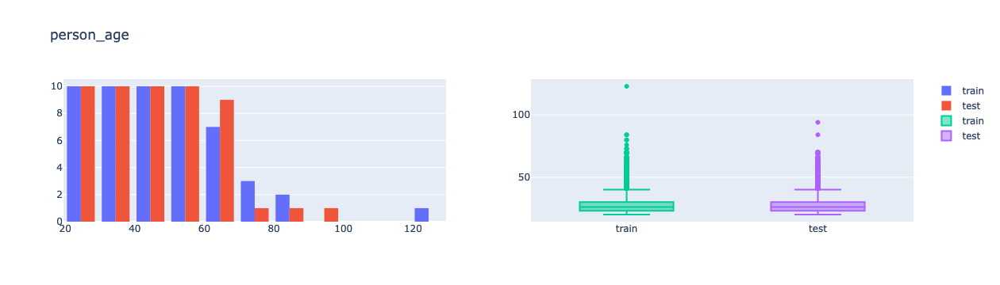

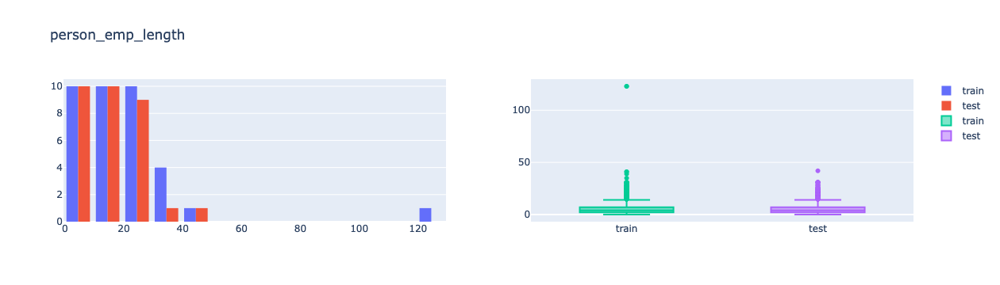

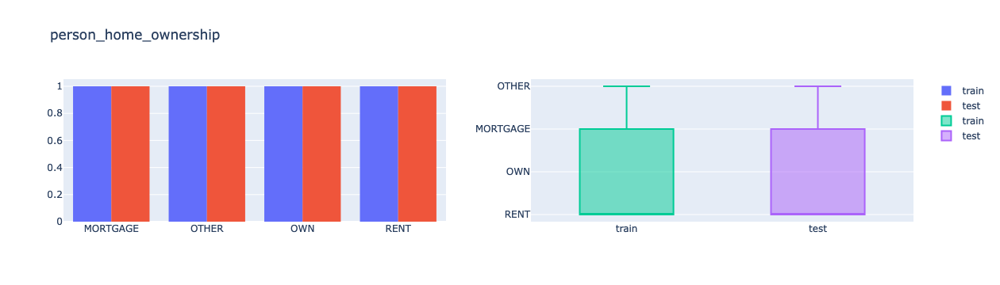

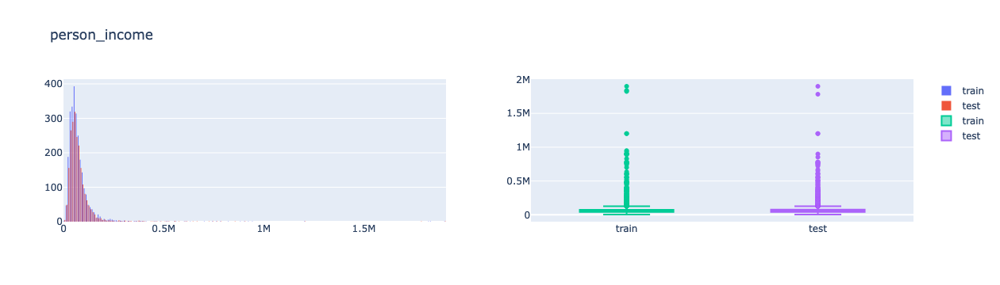

In [10]:
cols = sorted(set(train_df.columns) - {"id", "loan_status"})
n_cols = len(cols)
for idx, col in enumerate(cols):
    fig = make_subplots(rows=1, cols=2)
    train_value_counts = train_df[col].value_counts().sort_index()
    test_value_counts = test_df[col].value_counts().sort_index()
    fig.add_traces(
        [
            # go.Bar(x=train_value_counts.index, y=train_value_counts, name="train"),
            # go.Bar(x=test_value_counts.index, y=test_value_counts, name="test"),
            go.Histogram(x=train_value_counts.index, y=train_value_counts, name="train"),
            go.Histogram(x=test_value_counts.index, y=test_value_counts, name="test"),
        ],
        rows=1,
        cols=1,
    )
    fig.add_traces(
        [
            go.Box(y=train_df[col], name="train"),
            go.Box(y=test_df[col], name="test"),
        ],
        rows=1,
        cols=2,
    )
    fig.update_layout(title_text=col)
    fig.show()